<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Exploratory-Data-Analysis" data-toc-modified-id="Exploratory-Data-Analysis-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Exploratory Data Analysis</a></span><ul class="toc-item"><li><span><a href="#Description-of-data-at-a-glance" data-toc-modified-id="Description-of-data-at-a-glance-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Description of data at a glance</a></span></li><li><span><a href="#Analysisng-the-Classes" data-toc-modified-id="Analysisng-the-Classes-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>Analysisng the Classes</a></span></li><li><span><a href="#Analysing-the-features" data-toc-modified-id="Analysing-the-features-1.3"><span class="toc-item-num">1.3&nbsp;&nbsp;</span>Analysing the features</a></span><ul class="toc-item"><li><span><a href="#Univariate-Analysis" data-toc-modified-id="Univariate-Analysis-1.3.1"><span class="toc-item-num">1.3.1&nbsp;&nbsp;</span>Univariate Analysis</a></span><ul class="toc-item"><li><span><a href="#Skewness-and-Kurtosis-Analysis" data-toc-modified-id="Skewness-and-Kurtosis-Analysis-1.3.1.1"><span class="toc-item-num">1.3.1.1&nbsp;&nbsp;</span>Skewness and Kurtosis Analysis</a></span></li></ul></li><li><span><a href="#Bivariate-Analysis" data-toc-modified-id="Bivariate-Analysis-1.3.2"><span class="toc-item-num">1.3.2&nbsp;&nbsp;</span>Bivariate Analysis</a></span></li></ul></li><li><span><a href="#Correlation-Analysis" data-toc-modified-id="Correlation-Analysis-1.4"><span class="toc-item-num">1.4&nbsp;&nbsp;</span>Correlation Analysis</a></span><ul class="toc-item"><li><span><a href="#Cleaning-the-data" data-toc-modified-id="Cleaning-the-data-1.4.1"><span class="toc-item-num">1.4.1&nbsp;&nbsp;</span>Cleaning the data</a></span><ul class="toc-item"><li><span><a href="#Dealing-with-missing-values" data-toc-modified-id="Dealing-with-missing-values-1.4.1.1"><span class="toc-item-num">1.4.1.1&nbsp;&nbsp;</span>Dealing with missing values</a></span></li><li><span><a href="#Checking-for-negative-values" data-toc-modified-id="Checking-for-negative-values-1.4.1.2"><span class="toc-item-num">1.4.1.2&nbsp;&nbsp;</span>Checking for negative values</a></span></li><li><span><a href="#Outlier-Removal" data-toc-modified-id="Outlier-Removal-1.4.1.3"><span class="toc-item-num">1.4.1.3&nbsp;&nbsp;</span>Outlier Removal</a></span></li></ul></li></ul></li></ul></li></ul></div>

<center><h1>Exploratory Data Analysis</h1></center>

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler

from pathlib import Path

from scipy.stats import iqr, zscore

from prettytable import PrettyTable, MSWORD_FRIENDLY, DEFAULT, PLAIN_COLUMNS

from collections import Counter
from tqdm import tqdm

import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.figure_factory as ff

from IPython.display import Image, display

In [3]:
data_folder = Path("./DryBeanDataset/")

In [4]:
data_path = data_folder.joinpath("Dry_Bean_Dataset.csv")

In [5]:
df = pd.read_csv(data_path)

In [6]:
df.head()

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4,Class
0,28395,610.291,208.178117,173.888747,1.197191,0.549812,28715,190.141097,0.763923,0.988856,0.958027,0.913358,0.007332,0.003147,0.834222,0.998724,SEKER
1,28734,638.018,200.524796,182.734419,1.097356,0.411785,29172,191.272751,0.783968,0.984986,0.887034,0.953861,0.006979,0.003564,0.909851,0.998430,SEKER
2,29380,624.110,212.826130,175.931143,1.209713,0.562727,29690,193.410904,0.778113,0.989559,0.947849,0.908774,0.007244,0.003048,0.825871,0.999066,SEKER
3,30008,645.884,210.557999,182.516516,1.153638,0.498616,30724,195.467062,0.782681,0.976696,0.903936,0.928329,0.007017,0.003215,0.861794,0.994199,SEKER
4,30140,620.134,201.847882,190.279279,1.060798,0.333680,30417,195.896503,0.773098,0.990893,0.984877,0.970516,0.006697,0.003665,0.941900,0.999166,SEKER


We won't be making aby changes on the original dataframe. So, let's make a deepcopy of the original

In [7]:
df_copy = df.copy()

## Description of data at a glance

We will use this dataframe for further analysis

In [8]:
desc = df_copy.describe()
desc

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4
count,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000
mean,53048.284549,855.283459,320.141867,202.270714,1.583242,0.750895,53768.200206,253.064220,0.749733,0.987143,0.873282,0.799864,0.006564,0.001716,0.643590,0.995063
std,29324.095717,214.289696,85.694186,44.970091,0.246678,0.092002,29774.915817,59.177120,0.049086,0.004660,0.059520,0.061713,0.001128,0.000596,0.098996,0.004366
min,20420.000000,524.736000,183.601165,122.512653,1.024868,0.218951,20684.000000,161.243764,0.555315,0.919246,0.489618,0.640577,0.002778,0.000564,0.410339,0.947687
25%,36328.000000,703.523500,253.303633,175.848170,1.432307,0.715928,36714.500000,215.068003,0.718634,0.985670,0.832096,0.762469,0.005900,0.001154,0.581359,0.993703
50%,44652.000000,794.941000,296.883367,192.431733,1.551124,0.764441,45178.000000,238.438026,0.759859,0.988283,0.883157,0.801277,0.006645,0.001694,0.642044,0.996386
75%,61332.000000,977.213000,376.495012,217.031741,1.707109,0.810466,62294.000000,279.446467,0.786851,0.990013,0.916869,0.834270,0.007271,0.002170,0.696006,0.997883
max,254616.000000,1985.370000,738.860154,460.198497,2.430306,0.911423,263261.000000,569.374358,0.866195,0.994677,0.990685,0.987303,0.010451,0.003665,0.974767,0.999733


A brief overview of the dataframe 

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13611 entries, 0 to 13610
Data columns (total 17 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Area             13611 non-null  int64  
 1   Perimeter        13611 non-null  float64
 2   MajorAxisLength  13611 non-null  float64
 3   MinorAxisLength  13611 non-null  float64
 4   AspectRation     13611 non-null  float64
 5   Eccentricity     13611 non-null  float64
 6   ConvexArea       13611 non-null  int64  
 7   EquivDiameter    13611 non-null  float64
 8   Extent           13611 non-null  float64
 9   Solidity         13611 non-null  float64
 10  roundness        13611 non-null  float64
 11  Compactness      13611 non-null  float64
 12  ShapeFactor1     13611 non-null  float64
 13  ShapeFactor2     13611 non-null  float64
 14  ShapeFactor3     13611 non-null  float64
 15  ShapeFactor4     13611 non-null  float64
 16  Class            13611 non-null  object 
dtypes: float64(1

In [10]:
len(df_copy)

13611

In [11]:
CLASSES = df_copy.Class.unique()
CLASSES

array(['SEKER', 'BARBUNYA', 'BOMBAY', 'CALI', 'HOROZ', 'SIRA', 'DERMASON'],
      dtype=object)

- We have 16 features, 12 dimensional and 4 shape features
- The `Class` column contains the Classes
- We have 13,611 rows each corresponding to 16 features per bean
- We have got 5 different classes: 'SEKER', 'BARBUNYA', 'BOMBAY', 'CALI', 'HOROZ', 'SIRA', 'DERMASON'

In [12]:
FEATURE_COLUMNS = df.columns.to_list()[:-1]

## Analysisng the Classes

In [13]:
fig = px.pie(data_frame=df_copy, names="Class")
fig.show()

In [14]:
px.histogram(data_frame=df_copy, x="Class")

*Obvservation*

- We have got 7 classes and above are the counts of the classes. As, we can see that the majority class is `DERMASON` and minority one is `BOMBAY`. The data is imbalanced as `BOMBAY` has only 500 examples where as `DERMASON` has 3500 examples. 

## Analysing the features

### Univariate Analysis

In [15]:
def plot_feats(typ="hist", title="Features with their distributions"):
    """
    This function can be used to plot all the features in the
    dataset as subplots with a specific type of plot.

    Currently only 3 type of plots supported : {'hist', 'bar', 'box'}

    Parameters
    ----------
    df_copy: pd.Dataframe
        The dataframe

    typ: str {'hist', 'bar', 'box'}
        The type of plot to be used

    title: str
        Title of the complete Figure.

    Returns
    -------
    fig: plotly.graph_objs._figure.Figure
        The Plotly figure

    """
    fig = make_subplots(rows=4, cols=4)
    k = 0

    Types = {
        "hist": go.Histogram,
        "bar": go.Bar,
        "box": go.Box,
    }

    for i in range(1, 5):
        for j in range(1, 5):
            fig.add_trace(
                Types[typ](
                    x=df_copy[FEATURE_COLUMNS[k]],
                ),
                row=i,
                col=j,
            )
            fig.update_xaxes(title_text=FEATURE_COLUMNS[k], row=i, col=j)
            k += 1

    fig.update_layout(
        dict1={"title_text": title, "height": 1000, "width": 1000, "showlegend": False}
    )

    return fig

In [16]:
fig = plot_feats()
fig.show()

#### Skewness and Kurtosis Analysis

Skewness and Kurtosis is a measure of the tailedness of the distribution. 

### Bivariate Analysis

In [17]:
def plot_scatter(x, y):

    layout = go.Layout(
        title=f"{x} v/s {y}",
        xaxis=dict(title=x),
        yaxis=dict(title=y),
    )

    data = []

    for c in CLASSES:
        df_class = df[df_copy.Class == c]
        data.append(
            go.Scattergl(
                x=df_class[x],
                y=df_class[y],
                hovertemplate=[
                    f'{x}: {df_class.at[i, x]}<br>{y}: {df_class.at[i, y]}<br>Class: {df_class.at[i, "Class"]}'
                    for i in df_class.index
                ],
                mode="markers",
                marker=dict(opacity=0.75, colorscale="Jet"),
                name=c,
            )
        )

    f = go.Figure(data=data, layout=layout)
    f.show()

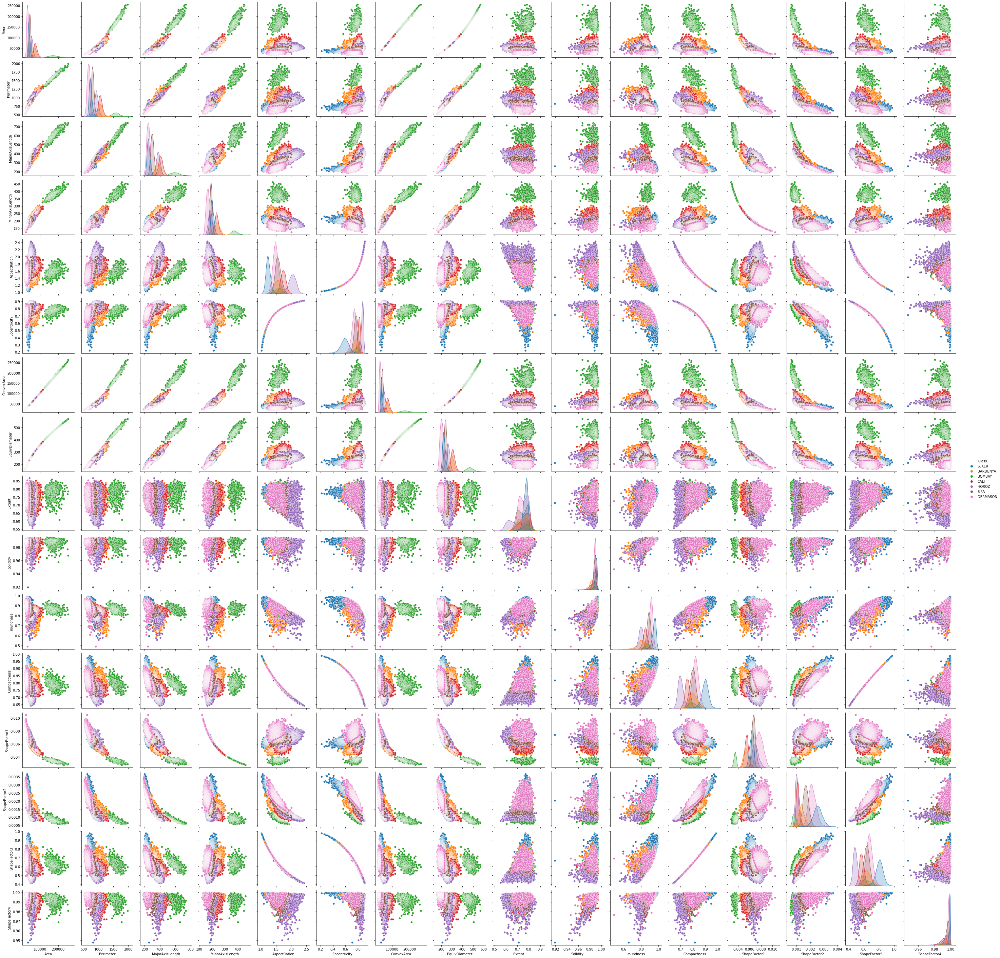

In [49]:
display(Image("pairplot.png"))

Since there are a lot of features, let's look at the pair plot first and then we can progress

*obvservation*

- So, it's kinda cumbersome, but still it gives us some details about it our data
- The green colored points are points belonging to `BOMBAY` our minority class. It seems any feature is good enough for separating BOMBAY from other classe.
- We can't really say the same for other classes

We can zoom in on some of the plots and see up close for ourselves that BOMBAY is easy to separate

In [19]:
plot_scatter("Area", "Perimeter")

In [20]:
plot_scatter("ShapeFactor1", "ShapeFactor2")

In [21]:
plot_scatter("Area", "ShapeFactor4")

Now, lets zoom in on some features which are highly correlated to each other

In [22]:
plot_scatter("ShapeFactor3", "Eccentricity")

*Obvservation*

- ShapeFactor3 and Eccentricity are high negative correlation, they seem to be perfectly lining up

Few other features with high negative and positive correlation

In [23]:
plot_scatter("AspectRation", "Eccentricity")

In [24]:
plot_scatter("ConvexArea", "Area")

*Obvservation*

- This is pretty interesting to look at, Area and ConvexArea seem to be the exact same features. Makes sense as ConvexArea approximates Area to the closest convex polygon

Let's Move on to correlation analysis

## Correlation Analysis

In [25]:
corr = df_copy.corr()
corr

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4
Area,1.000000,0.966722,0.931834,0.951602,0.241735,0.267481,0.999939,0.984968,0.054345,-0.196585,-0.357530,-0.268067,-0.847958,-0.639291,-0.272145,-0.355721
Perimeter,0.966722,1.000000,0.977338,0.913179,0.385276,0.391066,0.967689,0.991380,-0.021160,-0.303970,-0.547647,-0.406857,-0.864623,-0.767592,-0.408435,-0.429310
MajorAxisLength,0.931834,0.977338,1.000000,0.826052,0.550335,0.541972,0.932607,0.961733,-0.078062,-0.284302,-0.596358,-0.568377,-0.773609,-0.859238,-0.568185,-0.482527
MinorAxisLength,0.951602,0.913179,0.826052,1.000000,-0.009161,0.019574,0.951339,0.948539,0.145957,-0.155831,-0.210344,-0.015066,-0.947204,-0.471347,-0.019326,-0.263749
AspectRation,0.241735,0.385276,0.550335,-0.009161,1.000000,0.924293,0.243301,0.303647,-0.370184,-0.267754,-0.766979,-0.987687,0.024593,-0.837841,-0.978592,-0.449264
Eccentricity,0.267481,0.391066,0.541972,0.019574,0.924293,1.000000,0.269255,0.318667,-0.319362,-0.297592,-0.722272,-0.970313,0.019920,-0.860141,-0.981058,-0.449354
ConvexArea,0.999939,0.967689,0.932607,0.951339,0.243301,0.269255,1.000000,0.985226,0.052564,-0.206191,-0.362083,-0.269922,-0.847950,-0.640862,-0.274024,-0.362049
EquivDiameter,0.984968,0.991380,0.961733,0.948539,0.303647,0.318667,0.985226,1.000000,0.028383,-0.231648,-0.435945,-0.327650,-0.892741,-0.713069,-0.330389,-0.392512
Extent,0.054345,-0.021160,-0.078062,0.145957,-0.370184,-0.319362,0.052564,0.028383,1.000000,0.191389,0.344411,0.354212,-0.141616,0.237956,0.347624,0.148502
Solidity,-0.196585,-0.303970,-0.284302,-0.155831,-0.267754,-0.297592,-0.206191,-0.231648,0.191389,1.000000,0.607150,0.303766,0.153388,0.343559,0.307662,0.702163


In [50]:
df_lt = corr.where(np.triu(np.ones(corr.shape)).astype(bool))

In [27]:
fig = go.Figure()
fig.add_trace(go.Heatmap(z=df_lt, x=corr.columns, y=corr.columns, colorscale="Jet"))

fig.show()

*Obvservation*

- As, we can see that most of our features are highly correlated either negatively or positively. 
- My hypothesis is even if we use very less features, we will still be able to descibe our data well.

Let's use PCA and see if that holds true. The idea of PCA is simple — reduce the number of variables of a data set, while preserving as much information as possible. 

In [28]:
df_feats = df_copy.copy()

scaler = StandardScaler()
df_feats[FEATURE_COLUMNS] = scaler.fit_transform(df_feats[FEATURE_COLUMNS])

In [29]:
pca = PCA(n_components=16, random_state=42)
pca.fit(df_feats[FEATURE_COLUMNS])

PCA(n_components=16, random_state=42)

In [30]:
X_pca = pca.transform(df_feats[FEATURE_COLUMNS])

In [31]:
layout = go.Layout(
    title="Components v/s % explained varaince",
    xaxis=dict(title="Components"),
    yaxis=dict(title="% explained variance"),
)

trace = go.Bar(
    x=list(range(1, 17)),
    y=pca.explained_variance_ratio_,
)

fig = go.Figure(data=trace, layout=layout)
fig.show()

In [32]:
px.scatter(data_frame=df_feats, x=X_pca[:, 0], y=X_pca[:, 1], color="Class")

In [33]:
plot_scatter("Area", "ShapeFactor1")

*Obvservation*

- It's interesting to see that just the first 5 components are good enough to explain 96 % of the data. If we take just 8 out of the 16 components, we can explain the whole data
- But PCA is like not so good for interpretebility. Nonetheless, it kind of validates my hypothesis

### Cleaning the data

#### Dealing with missing values 

In [34]:
Table = PrettyTable(["column", "NA count", "Null count"])
for column in df_copy.columns.to_list():
    Table.add_row([column, df[column].isna().sum(), df[column].isnull().sum()])

print(Table)

+-----------------+----------+------------+
|      column     | NA count | Null count |
+-----------------+----------+------------+
|       Area      |    0     |     0      |
|    Perimeter    |    0     |     0      |
| MajorAxisLength |    0     |     0      |
| MinorAxisLength |    0     |     0      |
|   AspectRation  |    0     |     0      |
|   Eccentricity  |    0     |     0      |
|    ConvexArea   |    0     |     0      |
|  EquivDiameter  |    0     |     0      |
|      Extent     |    0     |     0      |
|     Solidity    |    0     |     0      |
|    roundness    |    0     |     0      |
|   Compactness   |    0     |     0      |
|   ShapeFactor1  |    0     |     0      |
|   ShapeFactor2  |    0     |     0      |
|   ShapeFactor3  |    0     |     0      |
|   ShapeFactor4  |    0     |     0      |
|      Class      |    0     |     0      |
+-----------------+----------+------------+


*obvservation*

- As you can see, the dataset is fairly complete with no missing or na values. So, we don't need to deal with them

#### Checking for negative values

Since all the featues are either dimensional or derived from the dimensional features, thhe values can't be negative. Let's cehck for negative features.

In [35]:
df_copy[FEATURE_COLUMNS].lt(0).sum()

Area               0
Perimeter          0
MajorAxisLength    0
MinorAxisLength    0
AspectRation       0
Eccentricity       0
ConvexArea         0
EquivDiameter      0
Extent             0
Solidity           0
roundness          0
Compactness        0
ShapeFactor1       0
ShapeFactor2       0
ShapeFactor3       0
ShapeFactor4       0
dtype: int64

*Obvservation*

- All the columns have positive values which is good as we can now use all rows

#### Outlier Removal

Let's see the distirbution of the features

In [36]:
plot_feats(typ="box", title="Features with box-plots")

In [37]:
def percent_rows_retained(df_copy, _column, method="iqr"):
    """
    This function calculates the percentage of rows retained
    by using a single feature to remove outliers

    Parameters
    ----------
    df_copy: the dataframe

    _column: the feature to use for outlier removal

    method: {'iqr', 'zcore'}
        The method to use for outlier removal


    Returns
    -------
    percentage: the percentage of rows retained after outlier removal

    new_df: the new dataframe cleaned of outliers

    """
    _desc = df_copy.describe()

    rows_retianed = 0

    if method == "iqr":
        iqr_val = _desc[_column].loc["75%"] - _desc[_column].loc["25%"]
        udr_val = _desc[_column].loc["75%"] + (1.5 * iqr_val)
        ldr_val = _desc[_column].loc["25%"] - (1.5 * iqr_val)

        if ldr_val < 0:
            ldr_val = 0

        rows_retained = len(
            df_copy[(df_copy[_column] < udr_val) & (df_copy[_column] > ldr_val)]
        )
        total_rows = len(df_copy)

        new_df = df_copy[(df_copy[_column] < udr_val) & (df_copy[_column] > ldr_val)]

    if method == "zscore":
        zscore_val = zscore(df_copy[_column])

        idxs = np.where(zscore_val < 3)[0]

        rows_retained = len(df_copy.iloc[[*idxs]])
        total_rows = len(df_copy)

        new_df = df_copy.iloc[[*idxs]]

    percentage = round((rows_retained / total_rows) * 100, 3)

    return percentage, new_df

In [38]:
def apply_method(df_copy, method="iqr"):
    """
    This function applies the `percentage_rows_retained` method
    to all the features and returns a table containing the results

    Parameters
    ----------
    df_copy: the dataframe

    method: {'iqr', 'zcore'}
        The method to use for outlier removal


    Returns
    -------
    table: PrettyTable
        returns a table of type PrettyTable to be displayed
    """
    table = PrettyTable(["column", "method", "% data retained"])
    table.set_style(DEFAULT)
    for column in df_copy.columns[:-1].to_list():
        info = percent_rows_retained(df_copy, column, method=method)[0]
        table.add_row([column, method, info])

    return table

In [39]:
print(
    f"Maximum value of area -> {desc['Area'].loc['max']} \nMinimum value of area -> {desc['Area'].loc['min']}"
)

Maximum value of area -> 254616.0 
Minimum value of area -> 20420.0


Let's remove the outliers. We first calculate the inter-quartile range

In [40]:
iqr_area = desc.Area.loc["75%"] - desc.Area.loc["25%"]
print(f"The IQR for `Area` -> {iqr_area}")

The IQR for `Area` -> 25004.0


In [41]:
udr_area = desc.Area.loc["75%"] + (1.5 * iqr_area)
ldr_area = desc.Area.loc["25%"] - (1.5 * iqr_area)

print(
    f"Setting the upper data range to {desc.Area.loc['75%'] + (1.5 * iqr_area)} \n"
    f"Setting the lower data range to {desc.Area.loc['25%'] - (1.5 * iqr_area)}"
)

Setting the upper data range to 98838.0 
Setting the lower data range to -1178.0


The lower boundary goes into negatives! Area can't be negative. So, I am going to fix it at 0

In [42]:
ldr_area = 0
percent_rows_retained(df_copy, "Area")[0]

95.952

In [43]:
def save_file(fname, df_to_csv):
    """
    Save the cleaned Dataframe as a csv file

    Parameters
    ----------

    fname: the name of the new file

    df_to_csv: the cleaned Dataframe

    """

    if Path(fname).is_file():
        print("File already exists! Skipping...")
    else:
        df_to_csv.sample(frac=1).to_csv(fname, index=False)

In [44]:
table = apply_method(df_copy, method="zscore")
print(table.get_string(sortby="% data retained", reversesort=True))

+-----------------+--------+-----------------+
|      column     | method | % data retained |
+-----------------+--------+-----------------+
|    roundness    | zscore |      100.0      |
|     Solidity    | zscore |      100.0      |
|   ShapeFactor4  | zscore |      100.0      |
|      Extent     | zscore |      100.0      |
|   Eccentricity  | zscore |      100.0      |
|   ShapeFactor1  | zscore |      99.993     |
|   Compactness   | zscore |      99.993     |
|   ShapeFactor2  | zscore |      99.963     |
|   ShapeFactor3  | zscore |      99.941     |
|   AspectRation  | zscore |      99.89      |
| MajorAxisLength | zscore |      97.678     |
|    Perimeter    | zscore |      97.032     |
|  EquivDiameter  | zscore |      96.584     |
|    ConvexArea   | zscore |      96.451     |
|       Area      | zscore |      96.451     |
| MinorAxisLength | zscore |      96.268     |
+-----------------+--------+-----------------+


In [45]:
table1 = apply_method(df_copy, method="iqr")
print(table1.get_string(sortby="% data retained", reversesort=True))

+-----------------+--------+-----------------+
|      column     | method | % data retained |
+-----------------+--------+-----------------+
|   ShapeFactor2  |  iqr   |      100.0      |
|    roundness    |  iqr   |      99.331     |
|   Compactness   |  iqr   |      99.199     |
|   ShapeFactor3  |  iqr   |      98.567     |
|      Extent     |  iqr   |      97.98      |
| MajorAxisLength |  iqr   |      97.215     |
|   AspectRation  |  iqr   |      96.525     |
|    Perimeter    |  iqr   |      96.327     |
|  EquivDiameter  |  iqr   |      96.135     |
|   ShapeFactor1  |  iqr   |      96.084     |
|    ConvexArea   |  iqr   |      95.959     |
|       Area      |  iqr   |      95.952     |
| MinorAxisLength |  iqr   |      95.82      |
|   ShapeFactor4  |  iqr   |      94.365     |
|     Solidity    |  iqr   |      94.284     |
|   Eccentricity  |  iqr   |      93.806     |
+-----------------+--------+-----------------+


I will use then `Z-score` method to remove outliers. Let's go with the column `MajorAxisLength`, it will help us retain alomot 98 % of the data and also remove outliers

In [46]:
df_cleaned = percent_rows_retained(df_copy, "MajorAxisLength", method="zscore")[1]

In [47]:
df_cleaned.head(10)

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4,Class
0,28395,610.291,208.178117,173.888747,1.197191,0.549812,28715,190.141097,0.763923,0.988856,0.958027,0.913358,0.007332,0.003147,0.834222,0.998724,SEKER
1,28734,638.018,200.524796,182.734419,1.097356,0.411785,29172,191.272751,0.783968,0.984986,0.887034,0.953861,0.006979,0.003564,0.909851,0.998430,SEKER
2,29380,624.110,212.826130,175.931143,1.209713,0.562727,29690,193.410904,0.778113,0.989559,0.947849,0.908774,0.007244,0.003048,0.825871,0.999066,SEKER
3,30008,645.884,210.557999,182.516516,1.153638,0.498616,30724,195.467062,0.782681,0.976696,0.903936,0.928329,0.007017,0.003215,0.861794,0.994199,SEKER
4,30140,620.134,201.847882,190.279279,1.060798,0.333680,30417,195.896503,0.773098,0.990893,0.984877,0.970516,0.006697,0.003665,0.941900,0.999166,SEKER
5,30279,634.927,212.560556,181.510182,1.171067,0.520401,30600,196.347702,0.775688,0.989510,0.943852,0.923726,0.007020,0.003153,0.853270,0.999236,SEKER
6,30477,670.033,211.050155,184.039050,1.146768,0.489478,30970,196.988633,0.762402,0.984081,0.853080,0.933374,0.006925,0.003242,0.871186,0.999049,SEKER
7,30519,629.727,212.996755,182.737204,1.165591,0.513760,30847,197.124320,0.770682,0.989367,0.967109,0.925480,0.006979,0.003158,0.856514,0.998345,SEKER
8,30685,635.681,213.534145,183.157146,1.165852,0.514081,31044,197.659696,0.771561,0.988436,0.954240,0.925658,0.006959,0.003152,0.856844,0.998953,SEKER
9,30834,631.934,217.227813,180.897469,1.200834,0.553642,31120,198.139012,0.783683,0.990810,0.970278,0.912125,0.007045,0.003008,0.831973,0.999061,SEKER


In [48]:
save_file("Data_removed_outlier_zscore.csv", df_to_csv=df_cleaned)

File already exists! Skipping...
